# Image Analysis

**This notebook requires the image datasets, placed under data/images (see file_manager.image_folder)**
**This data is not included in the gdrive folder and needs to be accessed from the TUM Urban development drive**

In this notebook:
1. Image label evaluation -> Places365-labeling (labels were pre-computed in the pipeline)
2. Exploratory image clustering -> Image descriptor clustering (descriptors were pre-computed in the pipeline)
3. Image classification -> clustering+fine-tuning on train set + evaluation on test set

Questions to answer:
1. Which points of interest are there? / What are people making photos of?
2. Are buildings photographed more from the outside or inside?
3. Does the image content shift over time?

In [28]:
import pandas as pd
import numpy as np
import os
import seaborn as sns
import matplotlib.pyplot as plt
from IPython.display import Image, display
# nice library for displaying sets of images in tabs but hogs memory and lags out the notebook (in DataSpell, might work better with jupyter etc.)
import ipyplot
from tqdm.notebook import tqdm
from sklearn.decomposition import PCA
from util.clustering import show_images_row,viz_clusters, viz_clusters_compact, perform_clustering, cluster_and_plot, get_centroid_idx

[autoreload of util.clustering failed: Traceback (most recent call last):
  File "c:\users\nutzer\appdata\local\programs\python\python37\lib\site-packages\IPython\extensions\autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "c:\users\nutzer\appdata\local\programs\python\python37\lib\site-packages\IPython\extensions\autoreload.py", line 394, in superreload
    module = reload(module)
  File "c:\users\nutzer\appdata\local\programs\python\python37\lib\imp.py", line 314, in reload
    return importlib.reload(module)
  File "c:\users\nutzer\appdata\local\programs\python\python37\lib\importlib\__init__.py", line 169, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 630, in _exec
  File "<frozen importlib._bootstrap_external>", line 728, in exec_module
  File "<frozen importlib._bootstrap>", line 219, in _call_with_frames_removed
  File "C:\Users\Nutzer\Documents\IDP2\MySpace\IdP2 - gitlab\Analysis\util\clustering.p

In [29]:
# reload sub-modules on change
# UsageError: Line magic function `%` not found. -> make sure it's '%load_ext autoreload' and not '% load_ext autoreload' (with space)
%load_ext autoreload
%autoreload 2

# sns.set(rc={'figure.figsize': (20, 4)})
# sns.set(font_scale=1.5)  # 1.8
def reset_layout():
    sns.set(rc={'figure.figsize': (30, 8)})
    sns.set(font_scale=1.8)  # 1.8


reset_layout()

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Helper functions

In [30]:
def get_images_from_imagelist(image_list_path):
    with open(image_list_path, "r") as f:
        return np.array(f.read().splitlines())


def image_name_to_index(fname, imagelist):
    return int(np.where(imagelist == fname)[0][0])

def display_sample_images(df, image_folder, labels, project, images_per_category=10, categories=False,
                          pick_randomly=True):
    """
    Helper function for visualizing image labels
    :param df:
    :param image_folder: path to image dataset
    :param labels: labels for scenes or categories (if use_categories=true)
    :param project: project name
    :param images_per_category: number of images to show per category
    :param categories: whether to use scenes (columns of the table) (false) or categories (row in the table) (true)
    :param pick_randomly pick images randomly. If False will pick images from the front of the image folder
    :return:
    """
    for label in labels:
        if categories:
            slice = df.loc[df["category"] == label, "image"]
        else:
            slice = df.loc[df[label] == 1, "image"]
        if pick_randomly:
            fnames = np.random.choice(slice, images_per_category, replace=False)
        else:
            fnames = categories[:images_per_category]
        fpaths = [os.path.join(image_folder, img) for img in fnames]
        show_images_row(fpaths,
                        title="{}: {} ({} images: {:.1%})".format(project, label, len(slice), len(slice) / len(df)))

## Read the data

In [31]:
from util import file_manager

output_dir = "output/ImageAnalysis"
os.makedirs(output_dir, exist_ok=True)
data = {}

# read image labels
label_df = file_manager.get_image_labels()
df_projects = file_manager.get_projects()

# read datasets
for idx, row in tqdm(df_projects.iterrows(), total=len(df_projects)):
    dataset, project = row["Dataset"], row["Handle"]
    project_image_folder = file_manager.image_folder / dataset
    # set up resources
    resources = {"df": label_df[label_df["project"] == project],
                "image_folder": project_image_folder / "images",
                 "image_db": get_images_from_imagelist(project_image_folder /  "image_db.txt"),
                 "features": np.load(project_image_folder / "image_features.npy"),
                 "opening": row["Opening"],
                 "completion": row["Completion"]}
    data[project] = resources

  0%|          | 0/16 [00:00<?, ?it/s]

## Image Labeling Evaluation
There used to be a more code here but I removed it since image labels didn't turn out to  be that useful compared to the feature vector approach
For now, we only look at the most broad label categories (indoor vs. outdoor) and ignore the finer-grained label categories

In [32]:
cat_level0 = ["indoor", "outdoor"]
# cat_level1 = ['indoor', 'outdoor, natural', 'outdoor, man-made']
# cat_level2 = ['shopping and dining', 'workplace (office building, factory, lab, etc.)', 'home or hotel',
#               'transportation (vehicle interiors, stations, etc.)',
#               'sports and leisure',
#               'cultural (art, education, religion, millitary, law, politics, etc.)',
#               'water, ice, snow', 'mountains, hills, desert, sky',
#               'forest, field, jungle', 'man-made elements',
#               'transportation (roads, parking, bridges, boats, airports, etc.)',
#               'cultural or historical building/place (millitary, religious)',
#               'sports fields, parks, leisure spaces', 'industrial and construction',
#               'houses, cabins, gardens, and farms',
#               'commercial buildings, shops, markets, cities, and towns']
# cat_level2_indoor = ['shopping and dining',
#                      'workplace (office building, factory, lab, etc.)', 'home or hotel',
#                      'transportation (vehicle interiors, stations, etc.)',
#                      'sports and leisure',
#                      'cultural (art, education, religion, millitary, law, politics, etc.)']
# cat_level2_outdoor_natural = ['water, ice, snow', 'mountains, hills, desert, sky',
#                               'forest, field, jungle', 'man-made elements']
# cat_level2_outdoor_manmade = ['transportation (roads, parking, bridges, boats, airports, etc.)',
#                               'cultural or historical building/place (millitary, religious)',
#                               'sports fields, parks, leisure spaces', 'industrial and construction',
#                               'houses, cabins, gardens, and farms',
#                               'commercial buildings, shops, markets, cities, and towns']
# cat_level2_short = [re.split("[ ,]", label)[0] for label in
#                     cat_level2]  # sports fields, parks, leisure spaces -> sports fields

Text(0.5, 1.0, 'Outdoor image Ratio by Case Study')

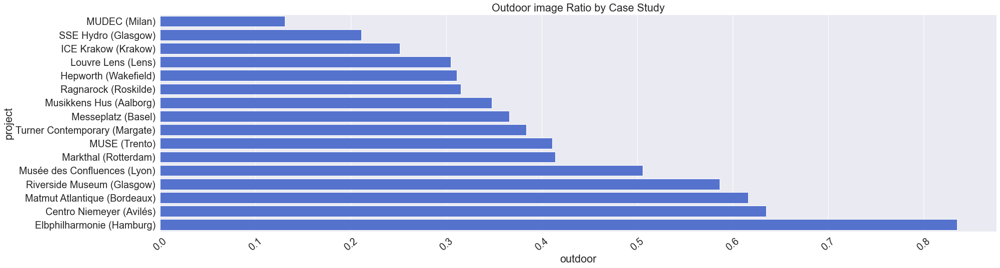

In [33]:
perc = []
for i, project in enumerate(data):
    res = data[project]
    df = res["df"]
    indoor_ratio = len(df[df["io"] == "indoor"]) / len(df)
    outdoor_ratio = len(df[df["io"] == "outdoor"]) / len(df)
    perc.append({"project": project, "indoor": indoor_ratio, "outdoor": outdoor_ratio})
df_io = pd.DataFrame(perc).sort_values("outdoor")
df_io.set_index("project", inplace=True)

sns.barplot(y=df_io.index, x=df_io["outdoor"], color="royalblue")
plt.xticks(rotation=40)
plt.title("Outdoor image Ratio by Case Study")

## Exploratory analysis

## Image classification training+testing
Why do training/testing:
- get labels that are specific to this research
- make sure that the labels are accurate (i.e. clustering may produce clusters with a lot of noise)
important: image_db.txt and features.npy are in the same order. All other files not necessarily.

In [34]:
images_per_dataset = 500
train_dir = file_manager.train_test_folder
train_dir_image_folder = train_dir / "images_labeled"
train_features_file = train_dir / "features.npy"
train_imagelist_file = train_dir / "image_db.txt"
gt_labels_file = train_dir / "gt_labels.csv"

In [35]:
label_lookup = {
    1: "Programme",
    2: "Architecture",
    3: "Food",
    4: "People",
    5: "Unrelated"
}

### Get the ground truth image labels and image features for the train/test set

In [36]:
# labels
# the image labels are stored in the file metadata and were read into gt_labels.csv previously
gt_labels = pd.read_csv(gt_labels_file)
gt_labels["label"].value_counts() / len(gt_labels)

# feathers
train_imagedb = get_images_from_imagelist(train_imagelist_file)
features = np.load(train_features_file)
df_features = pd.DataFrame({"image": train_imagedb, "feature": list(features)})

# concat them
train_test = gt_labels.copy()
train_test = train_test.merge(df_features, on="image")
# add places365-labels
all_label_predictions = pd.concat([val["df"][["image", "class_pred"]] for val in data.values()])
train_test = train_test.merge(all_label_predictions, on="image", how="inner")
train_test

,image,label,feature,class_pred
0,1000012482900891155_3gwg4OQ5YT.jpg,2,"[-0.012333085, 0.0068486948, -0.0008234779, 0....",Architecture
1,1000190834169577770_3hZEOyR4Eq.jpg,1,"[-0.07827489, 0.0077054934, -0.06605587, 0.023...",Programme
2,1000511778552803797_3iiCliO_HV.jpg,1,"[-0.08965767, 0.03429025, 0.008586264, -0.0061...",Programme
3,1000743586922897866_3jWv15yiHK.jpg,2,"[-0.10150481, -0.001416999, 0.031402215, 0.025...",Architecture
4,1000829334174900398_3jqPoQSSCu.jpg,2,"[-0.09647101, 0.03650132, 0.032884903, -0.0195...",Architecture
...,...,...,...,...
7907,997964092717179803_3Zew4NAKOb.jpg,4,"[-0.07781876, 0.026883308, -0.055357568, -0.01...",People
7908,998336161867919818_3azXMmkHHK.jpg,1,"[-0.012176073, -0.041643467, -0.008739152, -0....",Programme
7909,998583889393414193_3brsG1uPAx.jpg,5,"[0.060255468, 0.0079506235, 0.113491505, -0.02...",Unrelated
7910,999029700050410971_3dRDgXkd3b.jpg,1,"[-0.031007156, -0.041845843, -0.010852136, -0....",Programme


### Create train and test set

In [37]:
test_set_size = 0.2
train_test["set"] = "train"
train_test.loc[
    np.random.choice(np.arange(len(train_test)), int(len(train_test) * test_set_size), replace=False), "set"] = "test"
train = train_test[train_test["set"] == "train"]
test = train_test[train_test["set"] == "test"]
train

,image,label,feature,class_pred,set
0,1000012482900891155_3gwg4OQ5YT.jpg,2,"[-0.012333085, 0.0068486948, -0.0008234779, 0....",Architecture,train
2,1000511778552803797_3iiCliO_HV.jpg,1,"[-0.08965767, 0.03429025, 0.008586264, -0.0061...",Programme,train
4,1000829334174900398_3jqPoQSSCu.jpg,2,"[-0.09647101, 0.03650132, 0.032884903, -0.0195...",Architecture,train
5,1001551947741768464_3mOjClP6sQ.jpg,2,"[-0.04816769, 0.076657265, 0.057180382, 0.0560...",Architecture,train
7,1002384918823476032_3pL8XWrptA.jpg,2,"[-0.06353667, -0.03234553, 0.011776299, 0.0282...",Architecture,train
...,...,...,...,...,...
7905,997865870029927245_3ZIbjMnrNN.jpg,1,"[0.00038281613, -0.014652268, -0.10441547, -0....",Programme,train
7906,997962838653838192_3ZeeoRAKNw.jpg,4,"[-0.07137846, -0.010439044, -0.036767054, -0.0...",People,train
7908,998336161867919818_3azXMmkHHK.jpg,1,"[-0.012176073, -0.041643467, -0.008739152, -0....",Programme,train
7910,999029700050410971_3dRDgXkd3b.jpg,1,"[-0.031007156, -0.041845843, -0.010852136, -0....",Programme,train


### Train the classifier and test using cross validation

In [38]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import cross_val_score

# set up knn predictor
neigh = KNeighborsClassifier(n_neighbors=10, weights="distance", metric="cosine")

# Cross validation
X, y = np.array(list(train_test["feature"])), train_test["label"].to_numpy()

cv = cross_val_score(neigh, X, y, cv=5)
print("CV accuracy: {:.1%}±{:.1%}".format(np.round(np.mean(cv), 2), np.round(np.std(cv), 2)))

# Get confusion matrix
X_train, y_train = np.array(list(train["feature"])), train[
    "label"].to_numpy()  # have to do this weird conversion to keep the (x, 2048 shape) of X
X_test, y_test = np.array(list(test["feature"])), test[
    "label"].to_numpy()  # have to do this weird conversion to keep the (x, 2048 shape) of X
neigh.fit(X_train, y_train)
preds_knn = neigh.predict(X_test)
confusion_matrix(y_test, preds_knn, normalize="all") * 100

CV accuracy: 80.0%±1.0%


array([[45.82806574,  2.78128951,  0.37926675,  0.18963338,  0.37926675],
       [ 1.89633375, 29.51959545,  0.        ,  0.06321113,  0.505689  ],
       [ 1.45385588,  0.        ,  1.45385588,  0.        ,  0.        ],
       [ 4.55120101,  2.14917826,  0.06321113,  0.82174463,  0.2528445 ],
       [ 2.97092288,  2.21238938,  0.06321113,  0.12642225,  2.33881163]])

### Show misclassifications

''

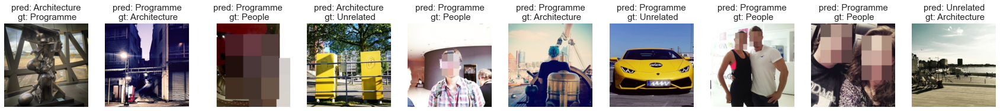

In [39]:
train_test["knn_pred"] = neigh.predict(list(train_test["feature"]))
mismatch = train_test[train_test["label"] != train_test["knn_pred"]]
fpaths, titles = [], []
for idx, row in list(mismatch.iterrows())[:10]:
    gt, pred, image = row["label"], row["knn_pred"], row["image"]
    titles.append("pred: {}\n gt: {}".format(label_lookup[pred], label_lookup[gt]))
    fpaths.append(os.path.join(train_dir_image_folder, image))
show_images_row(fpaths, titles)
""

-> accuracy is not perfect but neither is the grond truth labeling (blame the researcher :) )

## Exploratory Clustering

Finding the best number of clusters using silhouette score (calculations take some time)

In [40]:
# sns.set(rc={'figure.figsize': (15, 4)})
# sns.set(font_scale=1)
#
# for i, project in enumerate(data):
#     res = data[project]
#     print("\n" + project)
#     n_clusters = 3
#     resources = data[project]
#     # df, features, imagedb, image_folder = resources["df"], resources["features"], resources["image_db"], resources["image_folder"]
#
#     pca = PCA(n_components=20, random_state=42)
#     features = pca.fit_transform(res["features"])
#     plot_silhouette_score(features, KMeans, min_n=2, max_n=15)
#     plt.show()
#
# reset_layout()

In [41]:
# derived from silhouette scores
# highest score was taken except when the highest score was 2 and the score from 3 or 4 etc. was close enough (so that there is at least something interesting to observe which is hard for just 2 clusters)
n_clusters_dict = {
    "Centro Niemeyer (Avilés)": 5,
    "Elbphilharmonie (Hamburg)": 3,
    "Hepworth (Wakefield)": 2,
    "ICE Krakow (Krakow)": 6,
    "Louvre Lens (Lens)": 3,
    "Markthal (Rotterdam)": 4,
    "Matmut Atlantique (Bordeaux)": 3,
    "Messeplatz (Basel)": 2,
    "MUDEC (Milan)": 2,
    "MUSE (Trento)": 4,
    "Musée des Confluences (Lyon)": 4,
    "Musikkens Hus (Aalborg)": 12,
    "Ragnarock (Roskilde)": 3,
    "Riverside Museum (Glasgow)": 3,
    "SSE Hydro (Glasgow)": 6,
    "Turner Contemporary (Margate)": 3

}

#### Show example images for each cluster

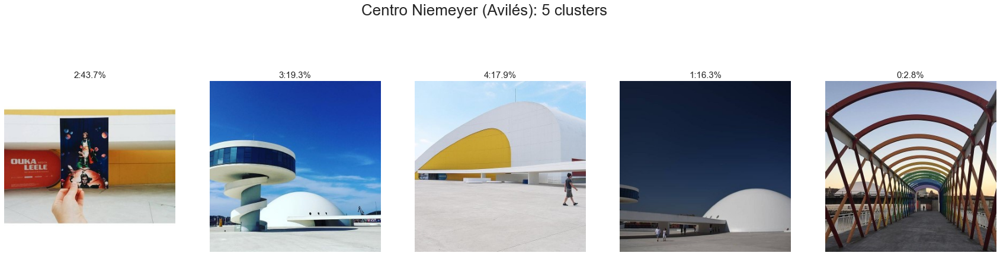

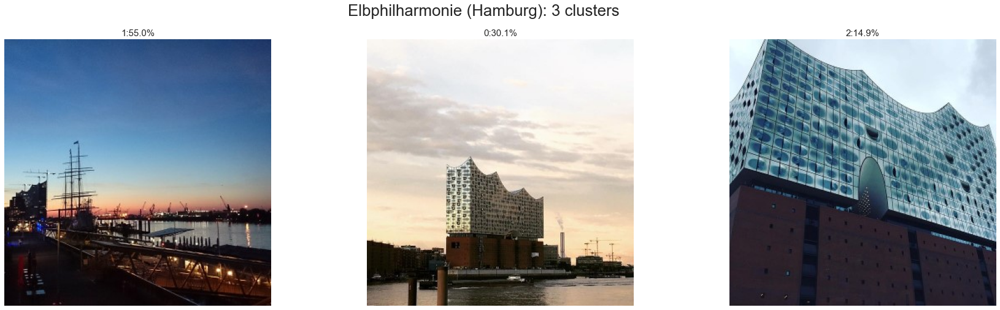

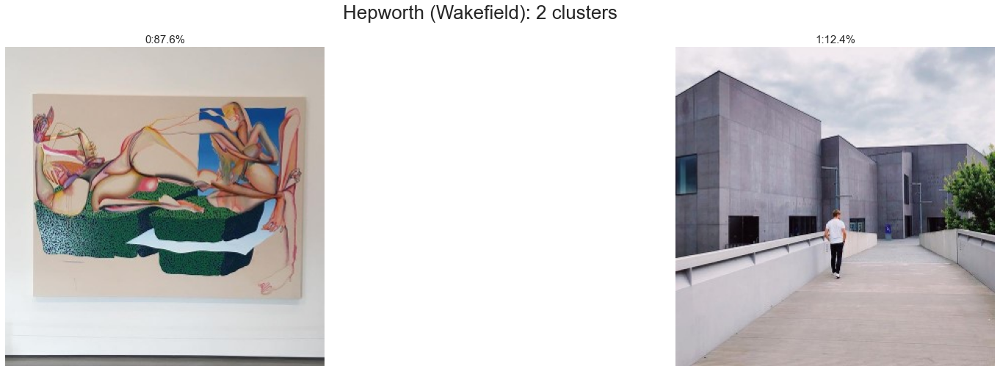

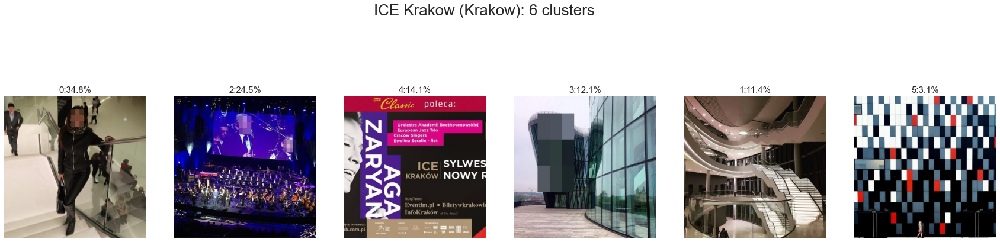

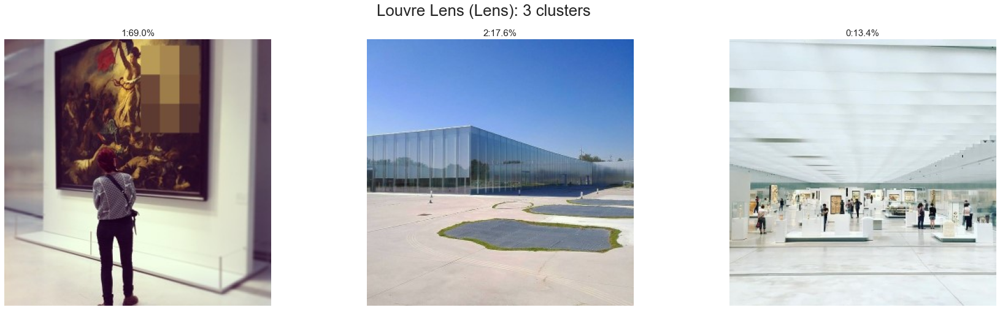

...

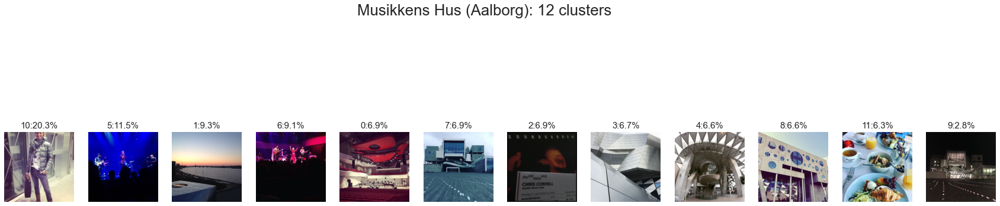

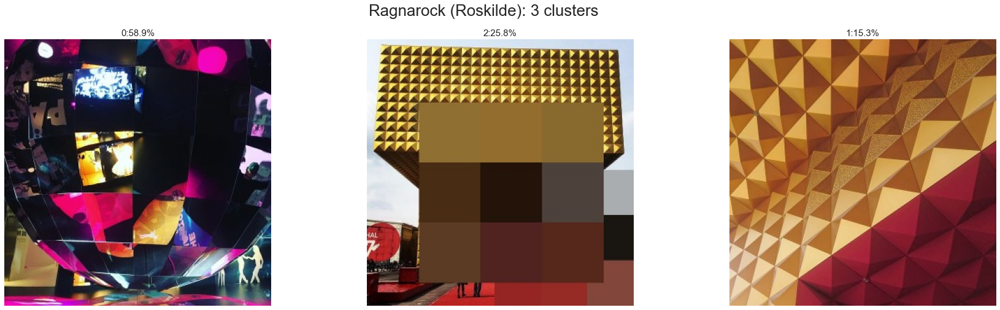

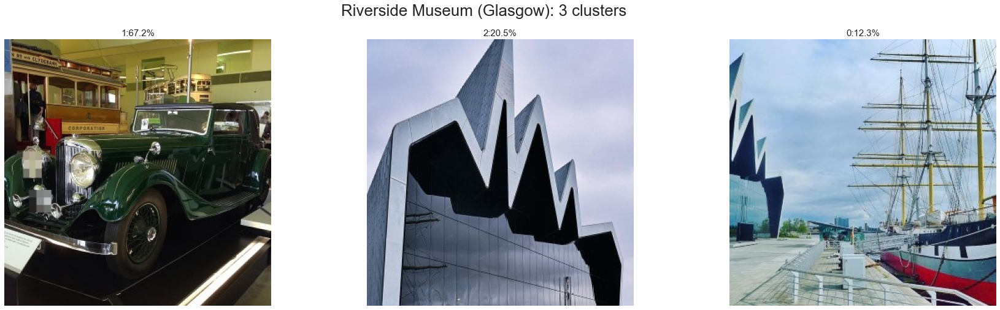

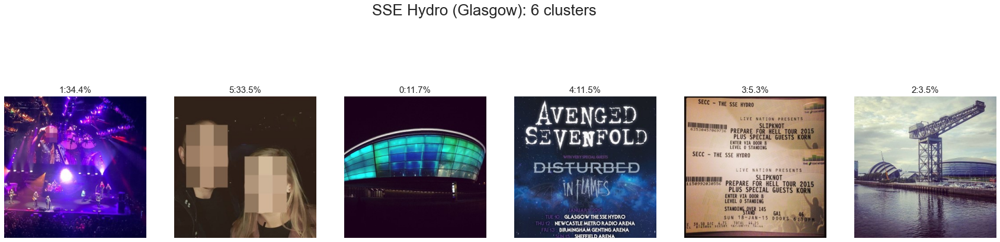

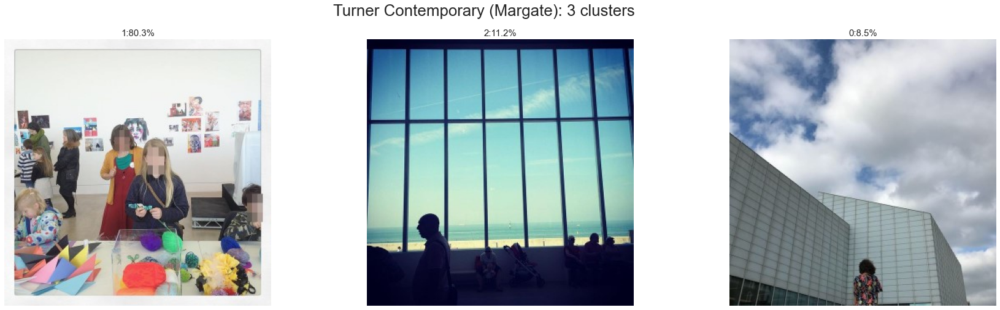

In [42]:
for i, project in enumerate(data):
    # get the data
    res = data[project]
    df, features, image_db, image_folder = res["df"], res["features"], res["image_db"], res["image_folder"]
    # perform clustering
    clustering, labels, labels_sorted, clusters, features_pca = perform_clustering(features=features,
                                                                                   n_clusters=n_clusters_dict[project])
    fig = viz_clusters_compact(clusters, image_db, image_folder, features)
    fig.suptitle("{}: {} clusters".format(project, len(clusters)))

## Classification Results Analysis

### Show example images for each class

In [43]:
classes = [1,2,3,4,5]
n_cols = 5
tmp = {}

neigh = KNeighborsClassifier(n_neighbors=10, weights="distance", metric="cosine")
X, y = np.array(list(train_test["feature"])), train_test["label"].to_numpy()
neigh.fit(X_train, y_train)

for i, project in tqdm(enumerate(data), total=len(data)):
    res = data[project]
    df, features, image_db, image_folder = res["df"], res["features"], res["image_db"], res["image_folder"]
    # perform clustering

    features_pca = PCA(n_components=20, random_state=42).fit_transform(features)
    labels = neigh.predict(features)
    tmp[project] = {c: np.where(labels == c)[0] for c in classes}

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

c:\users\nutzer\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:21: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


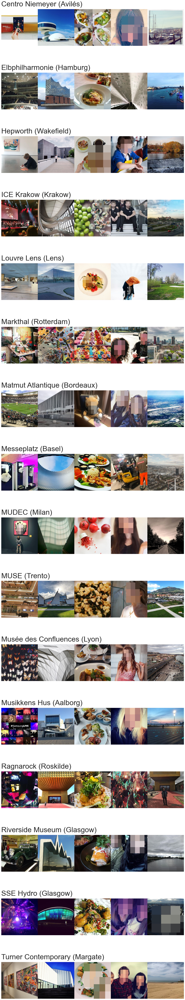

In [44]:
fig, axs = plt.subplots(16, n_cols, figsize=(18, 100), gridspec_kw = {'wspace':0, 'hspace':0.6})

for i, project in tqdm(enumerate(data), total=len(data)):

    # get the data
    res = data[project]
    df, features, image_db, image_folder = res["df"], res["features"], res["image_db"], res["image_folder"]
    # perform clustering
    clusters= tmp[project]

    for j in range(1,n_cols+1):
        idxs = clusters[j]
        idx = get_centroid_idx(idxs, features, 1)[0]
        img = plt.imread(os.path.join(image_folder, image_db[idx]))
        axs[i, j-1].axis('off')
        axs[i, j-1].imshow(img)
        if j == 1:
            axs[i, j-1].set_title(project, loc="Left", fontsize=40, pad=15)

# plt.subplots_adjust(wspace=0, hspace=0.25)
plt.tight_layout()

#### Outside clustering: Does one particular view angle of the outside emerge as dominant?
-> no growth of one particular cluster over time, except for Messe Basel

In [45]:
# best n_clusters for the 'Architecture' image subset acording to the silhouette score
n_clusters_arch_dict = {
    "Centro Niemeyer (Avilés)": 6,
    "Elbphilharmonie (Hamburg)": 2,
    "Hepworth (Wakefield)": 4,
    "ICE Krakow (Krakow)": 8,
    "Louvre Lens (Lens)": 3,
    "Markthal (Rotterdam)": 7,
    "Matmut Atlantique (Bordeaux)": 5,
    "Messeplatz (Basel)": 2,
    "MUDEC (Milan)": 2,
    "MUSE (Trento)": 3,
    "Musée des Confluences (Lyon)": 3,
    "Musikkens Hus (Aalborg)": 7,
    "Ragnarock (Roskilde)": 2,
    "Riverside Museum (Glasgow)": 5,
    "SSE Hydro (Glasgow)": 7,
    "Turner Contemporary (Margate)": 2

}

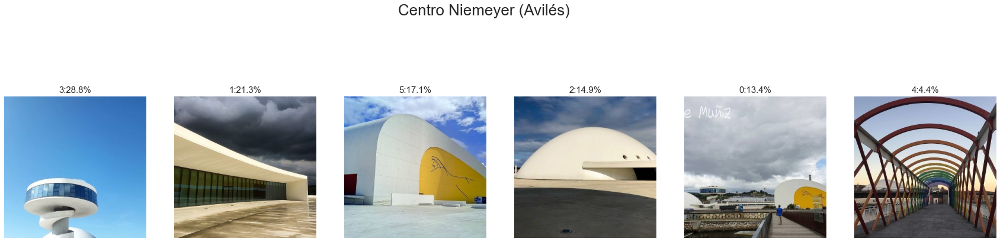

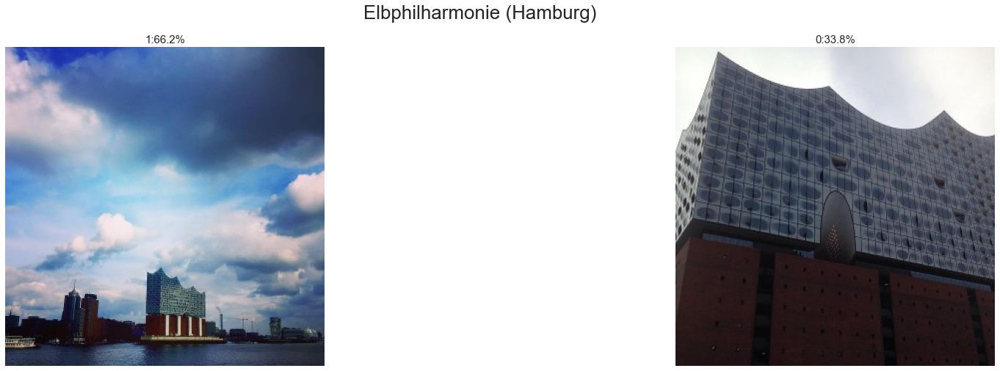

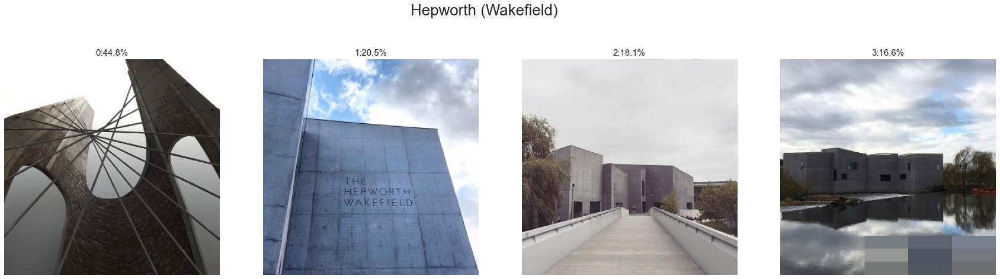

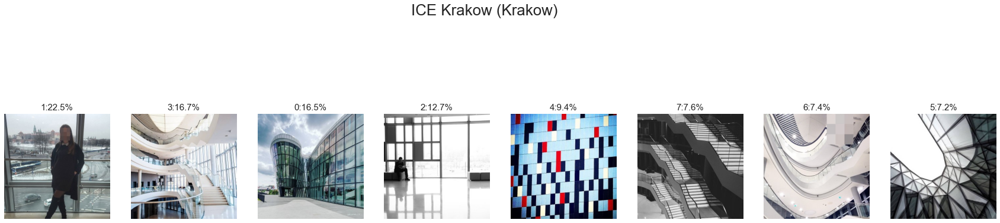

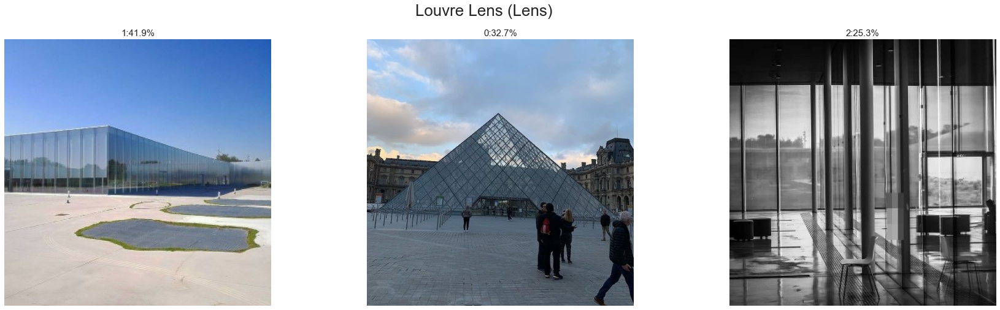

...

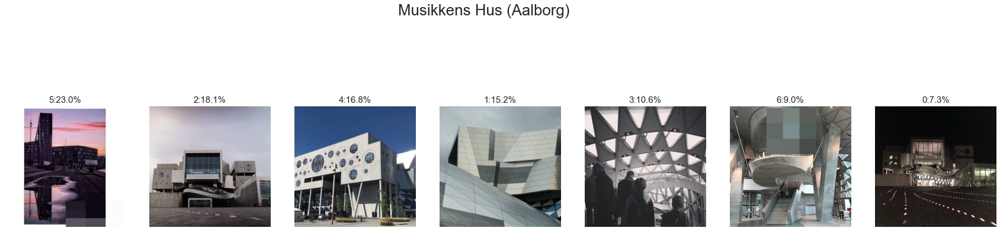

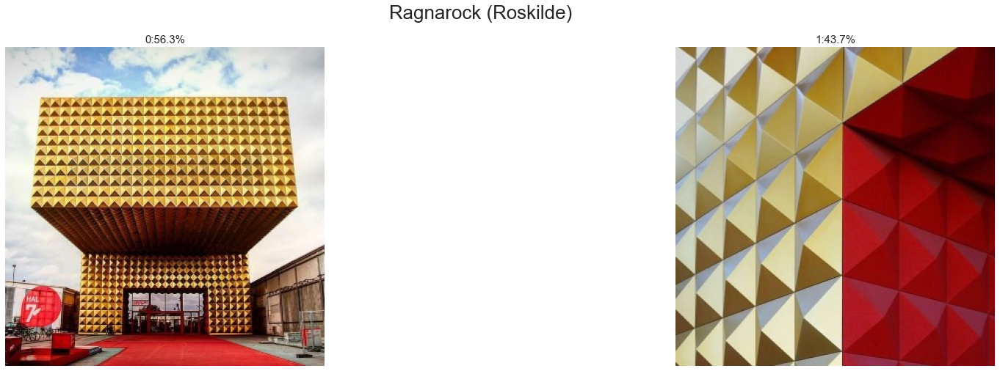

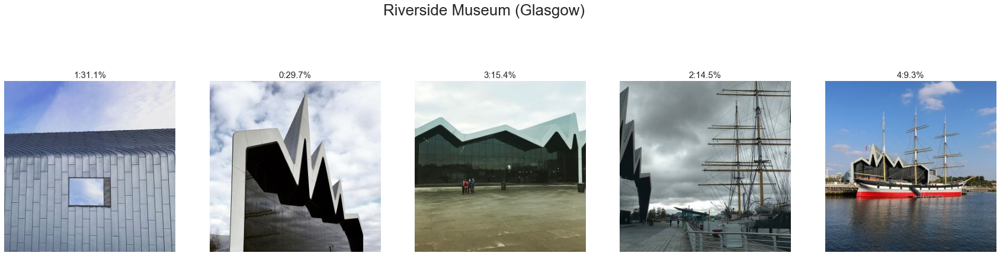

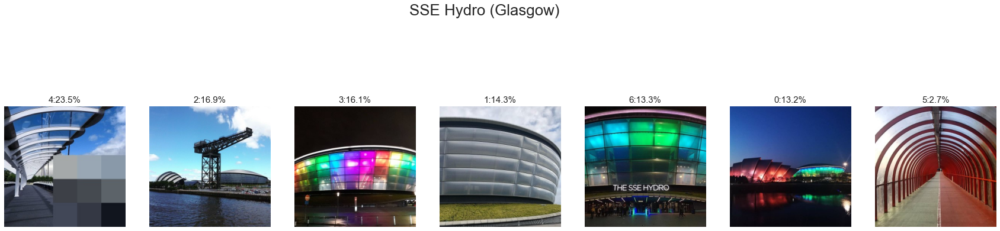

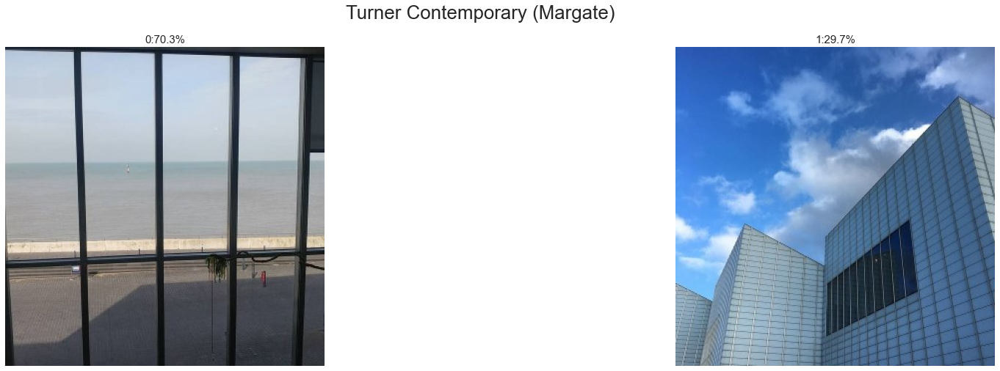

In [46]:
# n_cols =3
# fig, axs = plt.subplots(6, n_cols, figsize=[40, 25])
for i, project in enumerate(data):
    # get the data
    res = data[project]
    df, features, image_db, image_folder = res["df"], res["features"], res["image_db"], res["image_folder"]

    preds = neigh.predict(features)
    # PCA features for faster silhouette score
    features_pca = PCA(n_components=20, random_state=42).fit_transform(features)
    # only take pictures classified as 'Architecture'. Make sure to slice image_db too since the indices are relative to it
    features_slice = features_pca[preds == 2]
    image_db_slice = image_db[preds == 2]

    # print(project)
    # plot_silhouette_score(features_slice, KMeans, min_n=2, max_n=15)

    clustering, labels, labels_sorted, clusters, features_pca = perform_clustering(features=features_slice,
                                                                                   n_clusters=n_clusters_arch_dict[project])

    fig = viz_clusters_compact(clusters, image_db_slice, image_folder,features_slice)
    fig.suptitle("{}".format(project))

    # clustering_labels = pd.DataFrame({"image": image_db_slice, "cluster": labels})
    # clustering_labels_timestamp = clustering_labels.merge(df.reset_index()[["image", "timestamp"]],on="image", how="inner")
    # clustering_labels_timestamp.set_index("timestamp", inplace=True)
    # ax = axs[int(i / n_cols), i % n_cols]
    # sns.histplot(data=clustering_labels_timestamp.reset_index(), x=clustering_labels_timestamp.index, hue="cluster" ,multiple="fill", bins=8, ax=ax)
    # ax.set_title(project, fontsize=25)
# plt.tight_layout()
# reset_layout()

### Classification and results vizu

In [47]:
# create classifier and train
neigh = KNeighborsClassifier(n_neighbors=10, weights="distance", metric="cosine")
X, y = np.array(list(train_test["feature"])), train_test["label"].to_numpy()
neigh.fit(X_train, y_train)

collector = []
for i, project in tqdm(enumerate(data), total=len(data)):
    # get the data
    res = data[project]
    df, features, image_db, image_folder = res["df"], res["features"], res["image_db"], res["image_folder"]
    preds = neigh.predict(features)

    preds_df = pd.DataFrame({"project": project, "image": image_db, "class_pred": preds})
    collector.append(preds_df)
all_preds = pd.concat(collector, axis=0)
# transform class labels from numbers into text
all_preds["class_pred"] = all_preds["class_pred"].apply(lambda x: label_lookup[x])

  0%|          | 0/16 [00:00<?, ?it/s]

In [48]:
def truncate_project(name): return name.split("(")[0].strip()

In [49]:
# add timestamps
all_preds = label_df
all_preds["project_trunc"] = all_preds["project"].apply(truncate_project)
all_preds.rename(columns={"class_pred": "Prediction"}, inplace=True)
# output_file = os.path.join(output_dir, "class_preds.csv")
# all_preds.to_csv(output_file)

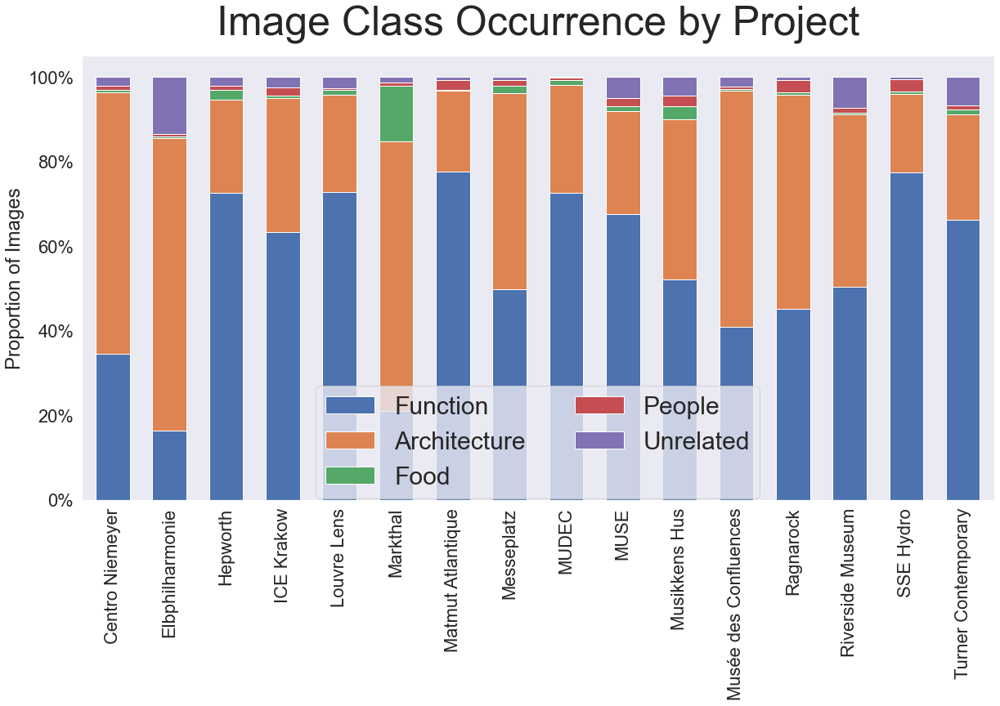

In [50]:
import matplotlib.ticker as mtick

sns.set(rc={'figure.figsize': (20, 10)})
sns.set(font_scale=2)


grp = all_preds.groupby(["project_trunc", "Prediction"])["image"].count().reset_index()
piv_data = grp.pivot(index="project_trunc", columns="Prediction", values="image")
piv_data_rel = piv_data.divide(piv_data.sum(axis=1), axis=0)
piv_data_rel = piv_data_rel[list(label_lookup.values())] # make sure the classes are ordered correctly

# sort by project. Python's sorting of lowercase vs. uppercase characters is different from my usual order of projects so I lowercase for the sorting
piv_data_rel["tmp"] = list(piv_data_rel.index)
piv_data_rel["tmp"] = piv_data_rel["tmp"].apply(lambda s :s.lower())
piv_data_rel_sorted = piv_data_rel.sort_values(by="tmp",ascending=True)
del piv_data_rel["tmp"]

piv_data_rel_sorted.rename(columns={"Programme": "Function"}, inplace=True)

ax = piv_data_rel_sorted.plot(kind="bar", stacked=True, width=0.6)
plt.title("Image Class Occurrence by Project", fontsize=50, pad=25)
plt.grid(False)
plt.ylabel("Proportion of Images")
plt.xlabel(None)

ax.yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1, decimals=0))
plt.legend(ncol=2, loc="lower center",bbox_to_anchor=(0.5, -0.025), fontsize=30)

In [51]:
piv_data_rel_sorted

Prediction,Function,Architecture,Food,People,Unrelated,tmp
project_trunc,,,,,,
Centro Niemeyer,0.344254,0.618826,0.005623,0.009046,0.022249,centro niemeyer
Elbphilharmonie,0.164213,0.690250,0.004194,0.006489,0.134853,elbphilharmonie
Hepworth,0.726219,0.219593,0.023663,0.009465,0.021060,hepworth
ICE Krakow,0.632155,0.317465,0.005111,0.019422,0.025847,ice krakow
Louvre Lens,0.726722,0.230792,0.010721,0.005360,0.026405,louvre lens
Markthal,0.209763,0.637871,0.130540,0.007914,0.013912,markthal
Matmut Atlantique,0.776758,0.190234,0.002148,0.022266,0.008594,matmut atlantique
Messeplatz,0.497808,0.463014,0.017397,0.014658,0.007123,messeplatz
MUDEC,0.725337,0.255772,0.010195,0.006897,0.001799,mudec


**Results**
- food, people and unrelated pics are negligible Exceptions
    - Elphi unrelated: blurry line between city pics and wide angle Elphi pics
    - Markthal food: part of the programme since it's a market
-

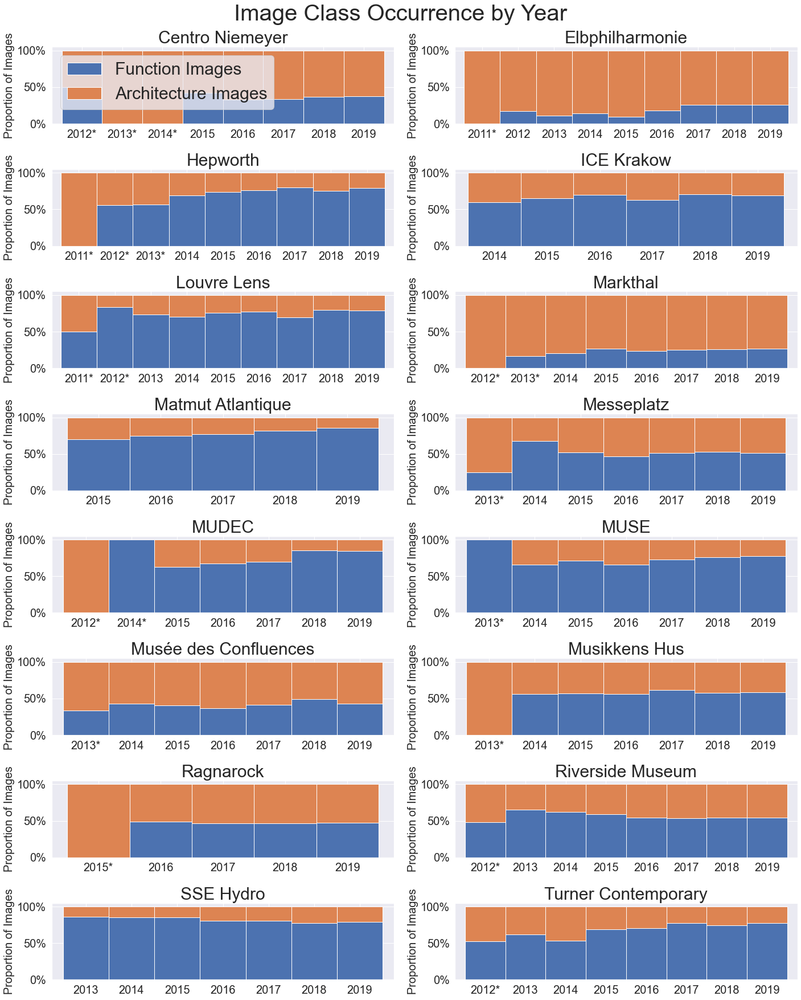

In [52]:
used_classes = ["Architecture", "Programme"] #  "Unrelated", "Food", "People",
reset_layout()
n_cols=2
fig, axs = plt.subplots(8, n_cols, figsize=[20, 25])
# sns.set(font_scale=5)
i=0
for project in data:

    # get the data
    slice = all_preds[(all_preds["project"] == project) & all_preds["Prediction"].isin(used_classes)]
    ax = axs[int(i / n_cols), i % n_cols]
    # reset_index to prevent (cannot re-index from duplicate axis which comes from having duplicates in the index)
    # sns.histplot(data=slice.reset_index(), x=slice.index.year, hue="Prediction", hue_order=used_classes ,multiple="fill", bins=8, ax=ax)
    grp= slice.groupby([slice.index.year, "Prediction"])["image"].count().reset_index()
    piv_data = grp.pivot(index="timestamp", columns="Prediction", values="image")
    piv_data_filtered = piv_data[["Programme", "Architecture"]] # re-order columns
    piv_data_rel = piv_data_filtered.divide(piv_data_filtered.sum(axis=1), axis=0)
    piv_data_rel.rename(columns={"Programme": "Function Images", "Architecture": "Architecture Images"}, inplace=True)
    piv_data_rel.plot(kind="bar", stacked=True,width=1.0, ax=ax) #, figsize=(7,15), width=0.6
    ax.legend(loc="upper left") # create custom legend layout
    if i !=0:
        ax.get_legend().remove()
    else:
        ax.legend(fontsize=30, loc="upper left")
    ax.yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1, decimals=0))
    ax.tick_params('x', labelrotation=0)
    ax.set_title(truncate_project(project), fontsize=30)
    ax.set_xlabel(None)
    ax.set_ylabel("Proportion of Images", fontsize=20)
    plt.grid(False)
    ax.tick_params(axis='both', which='major', labelsize=20)
    plt.tight_layout()

    # indicate years with low sample size
    min_samples = 100
    xtick_locations, xtick_labels  = ax.get_xticks(), ax.get_xticklabels()
    for j, label in enumerate(xtick_labels):
        try:
            if piv_data.iloc[j].sum() < min_samples:
                xtick_labels[j] = xtick_labels[j].get_text() + "*"
        except IndexError:
                pass
    ax.set_xticks(xtick_locations)
    ax.set_xticklabels(xtick_labels)

    i+=1

plt.suptitle("Image Class Occurrence by Year",fontsize=40)
plt.tight_layout()

## Statistical Testing

In [53]:
import scipy
collector = []
for i, project in enumerate(data):
    res = data[project]
    opening = res["opening"]
    slice = all_preds[(all_preds["project"] == project) & (all_preds.index  >= pd.to_datetime(opening))]

    grp= slice.groupby([slice.index.year, "Prediction"])["image"].count().reset_index()
    piv_data = grp.pivot(index="timestamp", columns="Prediction", values="image")
    piv_data = piv_data[piv_data.sum(axis=1) >= 100]
    piv_data.fillna(0, inplace=True)
    share = (piv_data["Architecture"] / piv_data.sum(axis=1)).rename("share").reset_index()
    res= scipy.stats.spearmanr(share["timestamp"], share["share"])

    sig = res.pvalue<0.05
    conclusion = ("Architecture" if res.correlation >0 else "Programme") if sig else ""
    collector.append({"project": project,"correlation": res.correlation,"pval": res.pvalue, "sig": sig, "conclusion": conclusion })

res = pd.DataFrame(collector).round(3)
res["project"] =res["project"].apply(truncate_project)
res

,project,correlation,pval,sig,conclusion
0,Centro Niemeyer,0.000,1.000,False,
1,Elbphilharmonie,0.500,0.667,False,
2,Hepworth,-0.829,0.042,True,Programme
3,ICE Krakow,-0.600,0.208,False,
4,Louvre Lens,-0.607,0.148,False,
5,Markthal,-0.429,0.397,False,
6,Matmut Atlantique,-1.000,0.000,True,Programme
7,Messeplatz,0.314,0.544,False,
8,MUDEC,-0.900,0.037,True,Programme
9,MUSE,-0.943,0.005,True,Programme


**Observations:**
Significant reduction for:
- Hepworth (to Programme)
- Matmut (to Programme)
- MUDEC (to Programme)
- MUSE (to Programme)
- Confluences (to Programme)
- SSE Hydro (to Architecture)
- Turner Contemporay (to Programme)